<a href="https://colab.research.google.com/github/nuvita97/music-source-separation/blob/dl-model/pre-trained.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MUSIC SOURCE SEPARATION

MUSDB... BSSEval...
- We use 2 approaches...

In [ ]:
!pip install mir_eval
!pip install musdb
!pip install museval
!pip install openunmix

In [ ]:
import torch
import torchaudio
import matplotlib.pyplot as plt
import pandas as pd

import musdb
from IPython.display import Audio
from mir_eval import separation
from torchaudio.pipelines import HDEMUCS_HIGH_MUSDB_PLUS
from torchaudio.utils import download_asset
from torchaudio.transforms import Fade

import warnings
warnings.filterwarnings('ignore')

# HYBRID-DEMUCS

[Hybrid Transformers for Music Source Separation](https://https://arxiv.org/pdf/2211.08553v1.pdf) - Simon Rouard, Francisco Massa, Alexandre Defossez

<img src="https://github.com/nuvita97/music-source-separation/blob/dl-model/images/hybrid-demucs.png?raw=1" alt="Hybrid-Demucs" style="width: 800px;"/>


## Processing

In [ ]:
bundle = HDEMUCS_HIGH_MUSDB_PLUS

model = bundle.get_model()

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

model.to(device)

sample_rate = bundle.sample_rate

print(f"Sample rate: {sample_rate}")

100%|██████████| 319M/319M [00:04<00:00, 67.9MB/s]


Sample rate: 44100


In [ ]:
#

def separate_sources(
    model,
    mix,
    segment=10.0,
    overlap=0.1,
    device=None,
):
    """
    Apply model to a given mixture. Use fade, and add segments together in order to add model segment by segment.

    Args:
        segment (int): segment length in seconds
        device (torch.device, str, or None): if provided, device on which to
            execute the computation, otherwise `mix.device` is assumed.
            When `device` is different from `mix.device`, only local computations will
            be on `device`, while the entire tracks will be stored on `mix.device`.
    """
    if device is None:
        device = mix.device
    else:
        device = torch.device(device)

    batch, channels, length = mix.shape

    chunk_len = int(sample_rate * segment * (1 + overlap))
    start = 0
    end = chunk_len
    overlap_frames = overlap * sample_rate
    fade = Fade(fade_in_len=0, fade_out_len=int(overlap_frames), fade_shape="linear")

    final = torch.zeros(batch, len(model.sources), channels, length, device=device)

    while start < length - overlap_frames:
        chunk = mix[:, :, start:end]
        with torch.no_grad():
            out = model.forward(chunk)
        out = fade(out)
        final[:, :, :, start:end] += out
        if start == 0:
            fade.fade_in_len = int(overlap_frames)
            start += int(chunk_len - overlap_frames)
        else:
            start += chunk_len
        end += chunk_len
        if end >= length:
            fade.fade_out_len = 0
    return final


def plot_spectrogram(stft, title="Spectrogram"):
    magnitude = stft.abs()
    spectrogram = 20 * torch.log10(magnitude + 1e-8).numpy()
    _, axis = plt.subplots(1, 1)
    axis.imshow(spectrogram, cmap="viridis", vmin=-60, vmax=0, origin="lower", aspect="auto")
    axis.set_title(title)
    plt.tight_layout()

In [ ]:
# We download the audio file from our storage. Feel free to download another file and use audio from a specific path

def separate_song(song, model=model):
# SAMPLE_SONG = download_asset("tutorial-assets/hdemucs_mix.wav")
  waveform, sample_rate = torchaudio.load(song.path)  # replace SAMPLE_SONG with desired path for different song
  waveform = waveform.to(device)
  mixture = waveform

  # parameters
  segment: int = 10
  overlap = 0.1

  # print("Separating track")

  ref = waveform.mean(0)
  waveform = (waveform - ref.mean()) / ref.std()  # normalization

  sources = separate_sources(
      model,
      waveform[None],
      device=device,
      segment=segment,
      overlap=overlap,
  )[0]
  sources = sources * ref.std() + ref.mean()

  sources_list = model.sources
  sources = list(sources)

  audios = dict(zip(sources_list, sources))
  return {'audios': audios,
          'mixture': mixture,
          'rate': sample_rate}

In [ ]:
N_FFT = 4096
N_HOP = 4
stft = torchaudio.transforms.Spectrogram(
    n_fft=N_FFT,
    hop_length=N_HOP,
    power=None,
)

In [ ]:
def sdr_score(original_source, predicted_source):
  score = separation.bss_eval_sources(original_source.detach().numpy(), predicted_source.detach().numpy())[0].mean()
  return score


def output_results(original_source: torch.Tensor, predicted_source: torch.Tensor, source: str, sample_rate):
    score = sdr_score(original_source, predicted_source)
    print("SDR score is: ", score)
    plot_spectrogram(stft(predicted_source)[0], f"Spectrogram - {source}")
    return Audio(predicted_source, rate=sample_rate)

In [ ]:


def get_results(audios, mixture, sample_rate):
  segment_start = 0
  segment_end = 10

  frame_start = segment_start * sample_rate
  frame_end = segment_end * sample_rate

  drums_spec = audios["drums"][:, frame_start:frame_end].cpu()
  drums = torch.from_numpy(track.targets['drums'].audio).T
  # print(drums.shape, drums_spec.shape, sample_rate)

  bass_spec = audios["bass"][:, frame_start:frame_end].cpu()
  bass = torch.from_numpy(track.targets['bass'].audio).T
  # print(bass.shape, bass_spec.shape, sample_rate)

  vocals_spec = audios["vocals"][:, frame_start:frame_end].cpu()
  vocals = torch.from_numpy(track.targets['vocals'].audio).T
  # print(vocals.shape, vocals_spec.shape, sample_rate)

  other_spec = audios["other"][:, frame_start:frame_end].cpu()
  other = torch.from_numpy(track.targets['other'].audio).T
  # print(other.shape, other_spec.shape, sample_rate)

  return {'drums': [drums, drums_spec],
          'bass': [bass, bass_spec],
          'vocals': [vocals, vocals_spec],
          'other': [other, other_spec]}

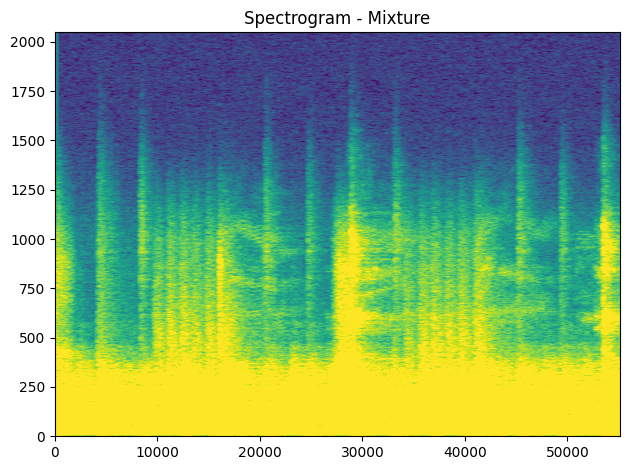

In [ ]:
# Mixture Clip
plot_spectrogram(stft(mix_spec)[0], "Spectrogram - Mixture")
Audio(mix_spec, rate=sample_rate)

SDR score is: 18.909251771345488


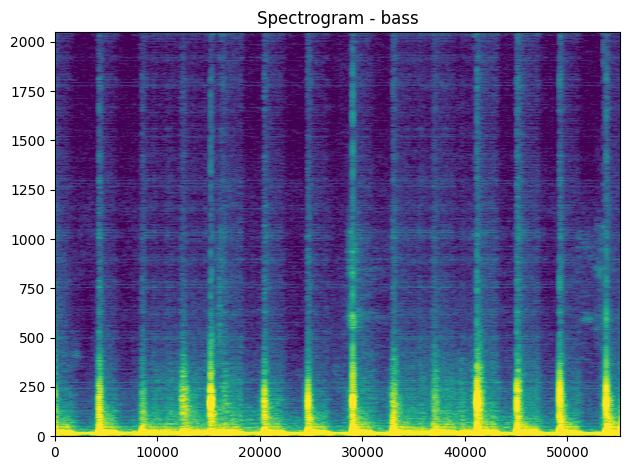

In [ ]:
# Bass Clip
output_results(bass, bass_spec, "bass")

In [ ]:

mus = musdb.DB(download=True)
mus_full = musdb.DB(root="/root/MUSDB18", is_wav=False)

In [ ]:
!ls /root/MUSDB18/MUSDB18-7/train/James May - On The Line


ls: cannot access '/root/MUSDB18/MUSDB18-7/train/James': No such file or directory
ls: cannot access 'May': No such file or directory
ls: cannot access '-': No such file or directory
ls: cannot access 'On': No such file or directory
ls: cannot access 'The': No such file or directory
ls: cannot access 'Line': No such file or directory


In [ ]:
track = mus[42]
print(track.name)
Audio(track.audio.T, rate=track.rate)

James May - On The Line


In [ ]:
torch.from_numpy(vocals.audio).T.shape

torch.Size([2, 300032])

In [ ]:
vocals = track.targets['vocals']
print(type(vocals))
Audio(vocals.audio.T, rate=track.rate)

<class 'musdb.audio_classes.Target'>


In [ ]:
# We download the audio file from our storage. Feel free to download another file and use audio from a specific path
SAMPLE_SONG = track.path
waveform, sample_rate = torchaudio.load(SAMPLE_SONG)  # replace SAMPLE_SONG with desired path for different song
waveform = waveform.to(device)
mixture = waveform

# parameters
segment: int = 10
overlap = 0.1

print("Separating track")

ref = waveform.mean(0)
waveform = (waveform - ref.mean()) / ref.std()  # normalization

sources = separate_sources(
    model,
    waveform[None],
    device=device,
    segment=segment,
    overlap=overlap,
)[0]
sources = sources * ref.std() + ref.mean()

sources_list = model.sources
sources = list(sources)

audios_mus = dict(zip(sources_list, sources))

Separating track


In [ ]:
audios_mus['drums'].shape

torch.Size([2, 300032])

In [ ]:
waveform.shape, sample_rate

(torch.Size([2, 300032]), 44100)

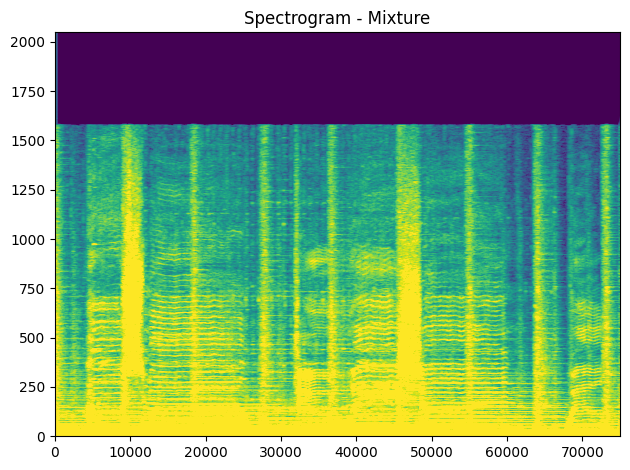

In [ ]:
# Mixture Clip
plot_spectrogram(stft(mix_spec)[0], "Spectrogram - Mixture")
Audio(mix_spec, rate=sample_rate)

SDR score is: 10.481270305588556


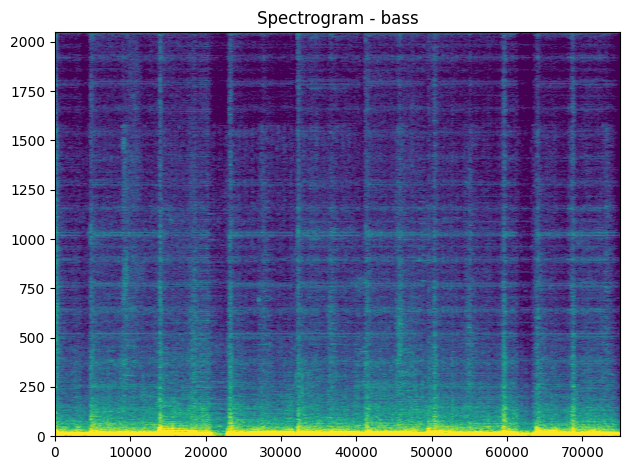

In [ ]:
# Bass Clip
output_results(bass, bass_spec, "bass")

SDR score is: 10.05065534891785


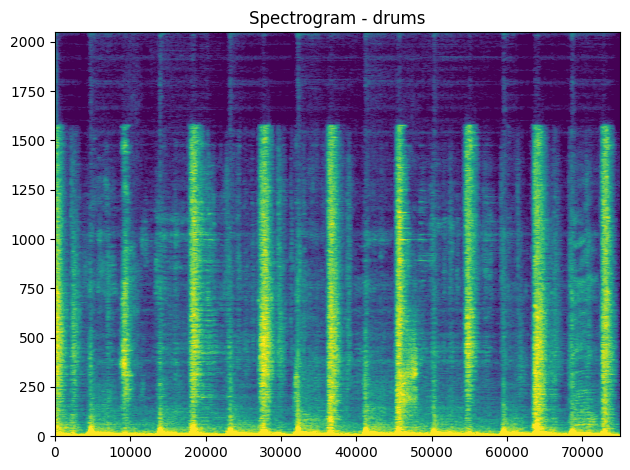

In [ ]:
# Drums Clip
output_results(drums, drums_spec, "drums")

## Evaluation

In [ ]:
df_score = pd.DataFrame(columns=['song', 'vocals', 'bass', 'drums', 'other'])

for track in mus:
  print(track)

  separated = separate_song(track)

  results = get_results(separated['audios'], separated['mixture'], separated['rate'])

  row = {}
  row['song']= track.name
  for component in results:
    comp_sdr = sdr_score(results[component][0], results[component][1])
    row[component] = comp_sdr

  df_score = df_score.append(row, ignore_index=True)


df_score

A Classic Education - NightOwl
ANiMAL - Clinic A
ANiMAL - Easy Tiger
ANiMAL - Rockshow
Actions - Devil's Words
Actions - One Minute Smile
Actions - South Of The Water
Aimee Norwich - Child
Alexander Ross - Goodbye Bolero
Alexander Ross - Velvet Curtain
Angela Thomas Wade - Milk Cow Blues
Atlantis Bound - It Was My Fault For Waiting
Auctioneer - Our Future Faces
AvaLuna - Waterduct
BigTroubles - Phantom
Bill Chudziak - Children Of No-one
Black Bloc - If You Want Success
Celestial Shore - Die For Us
Chris Durban - Celebrate
Clara Berry And Wooldog - Air Traffic
Clara Berry And Wooldog - Stella
Clara Berry And Wooldog - Waltz For My Victims
Cnoc An Tursa - Bannockburn
Creepoid - OldTree
Dark Ride - Burning Bridges
Dreamers Of The Ghetto - Heavy Love
Drumtracks - Ghost Bitch
Faces On Film - Waiting For Ga
Fergessen - Back From The Start
Fergessen - Nos Palpitants
Fergessen - The Wind
Flags - 54
Giselle - Moss
Grants - PunchDrunk
Helado Negro - Mitad Del Mundo
Hezekiah Jones - Borrowed Hear

,song,vocals,bass,drums,other
0,A Classic Education - NightOwl,5.045700,17.946731,4.631213,7.254381
1,ANiMAL - Clinic A,7.734875,15.731040,8.100952,4.339753
2,ANiMAL - Easy Tiger,8.079364,13.461731,11.215929,10.086861
3,ANiMAL - Rockshow,4.527728,1.400547,6.003610,-10.347504
4,Actions - Devil's Words,10.371531,9.471671,10.281704,6.036139
...,...,...,...,...,...
139,Timboz - Pony,5.725407,3.389919,4.709067,8.064884
140,Tom McKenzie - Directions,8.419180,6.958982,15.799019,1.461650
141,Triviul feat. The Fiend - Widow,10.612438,16.269107,6.266232,4.287933
142,We Fell From The Sky - Not You,6.665740,3.128714,13.645801,8.085654


In [ ]:
df_score.iloc[42]

song      James May - On The Line
vocals                   9.725447
bass                     10.48127
drums                   10.050655
other                    6.496032
Name: 42, dtype: object

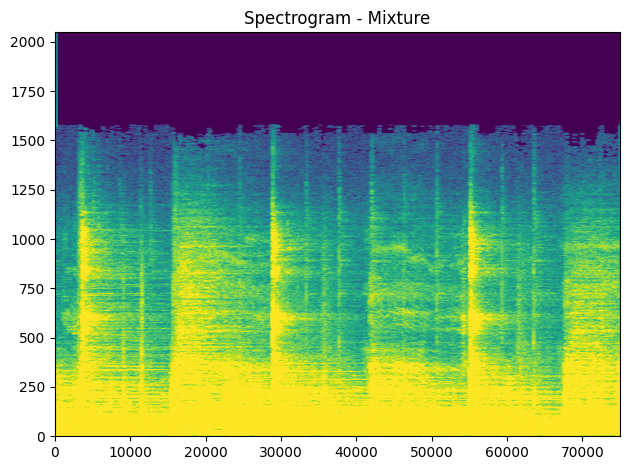

In [ ]:
# Mixture Clip

mix_spec = separated['mixture'][:, frame_start:frame_end].cpu()


plot_spectrogram(stft(mix_spec)[0], "Spectrogram - Mixture")
Audio(mix_spec, rate=separated['rate'])

SDR score is:  4.631212893571346


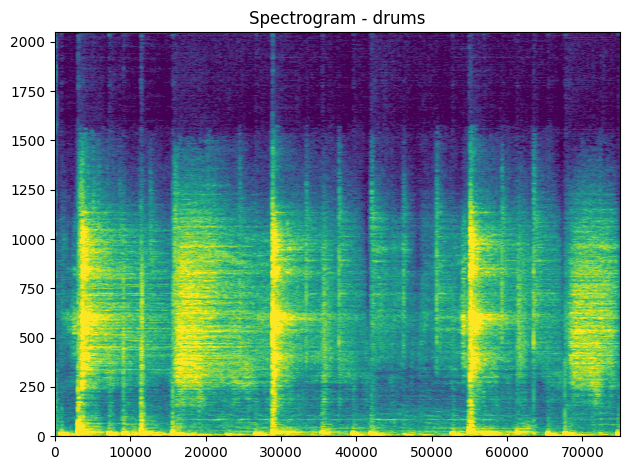

In [ ]:
# Drums Clip
output_results(results['drums'][0], results['drums'][1], "drums", separated['rate'])

In [ ]:
sdr_score(results['vocals'][0], results['vocals'][1])

5.045700428661282

In [ ]:
Audio(results['vocals'][1], rate=separated['rate'])


In [ ]:
separated['audios']

{'drums': tensor([[ 6.7477e-03,  3.9235e-04,  1.5408e-04,  ...,  4.7379e-05,
           4.7755e-05,  4.7555e-05],
         [-5.8025e-03, -3.4917e-03,  2.7969e-03,  ...,  4.6839e-05,
           4.7438e-05,  4.7555e-05]]),
 'bass': tensor([[-1.9284e-02, -3.6541e-02, -5.3394e-02,  ...,  4.5819e-05,
           4.7454e-05,  4.7555e-05],
         [-3.4678e-02, -4.0310e-02, -5.7852e-02,  ...,  4.6360e-05,
           4.8392e-05,  4.7555e-05]]),
 'other': tensor([[1.0740e-02, 1.3455e-03, 3.3226e-03,  ..., 4.6734e-05, 4.7505e-05,
          4.7555e-05],
         [4.3135e-02, 4.3596e-02, 3.5589e-02,  ..., 5.6016e-05, 5.2170e-05,
          4.7555e-05]]),
 'vocals': tensor([[ 1.5007e-03,  7.1748e-04, -3.4182e-04,  ...,  5.0995e-05,
           4.9186e-05,  4.7555e-05],
         [ 3.5651e-03,  3.9934e-03,  2.6363e-03,  ...,  4.3500e-05,
           4.5685e-05,  4.7555e-05]])}

# OPEN-UNMIX

"Open-Unmix - A Reference Implementation for Music Source Separation" - Fabian-Robert Stöter, Stefan Uhlich, Antoine Liutkus, and Yuki Mitsufuji3

<img src="https://github.com/nuvita97/music-source-separation/blob/dl-model/images/open-unmix.png?raw=1" alt="open-unmix" style="width: 800px;"/>

## Processing

In [ ]:
track = mus[42]
print(track.name)
display(Audio(track.audio.T, rate=track.rate))

James May - On The Line


In [ ]:
from openunmix import predict

estimates = predict.separate(
    torch.as_tensor(track.audio).float(),
    rate=track.rate,
    device=device
)
for target, estimate in estimates.items():
    print(target)
    audio = estimate.detach().cpu().numpy()[0]
    display(Audio(audio, rate=track.rate))

vocals


drums


bass


other


In [ ]:
estimates['vocals'].shape

torch.Size([1, 2, 300032])

In [ ]:
vocals_est = estimates['vocals'].squeeze(0)
vocals_org = torch.from_numpy(track.targets['vocals'].audio).T

sdr_score(vocals_org, vocals_est)

9.32649493240004

In [ ]:
vocals.shape

torch.Size([2, 300032])

In [ ]:
sdr_score(vocals, output_tensor)

8.799889031339799

SDR score is:  8.799889031339799


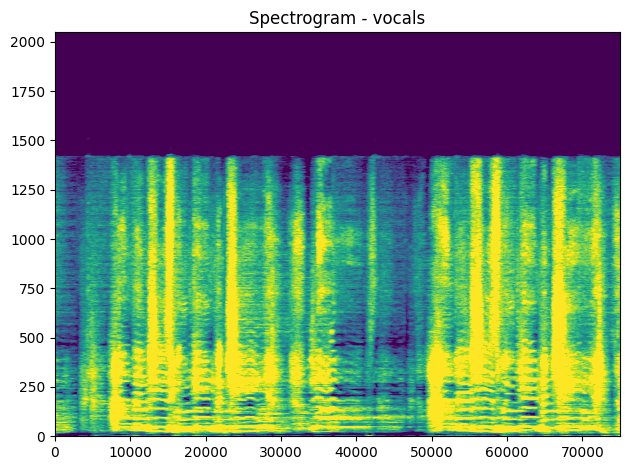

In [ ]:
output_results(vocals, output_tensor, "vocals", track.rate)

## Evaluation

In [ ]:
import stempeg

estimates_numpy = {}

for target, estimate in estimates.items():
    estimates_numpy[target] = torch.squeeze(estimate).detach().cpu().numpy().T

In [ ]:
track_scores = museval.eval_mus_track(track, estimates)
print(track_scores)

(300032, 2)

In [ ]:
df_umix =

# CONCLUSION